# ⭐ DCGAN 을 활용한 CIFAR-10 이미지 생성하기 ⭐


## ▶ 없던 데이터를 만들어 내는 생성 모델링
✅  생성 모델링은 지금까지 접해 보았던 기본적인 딥러닝 모델과는 조금 다르다고 하는데,
무엇이 다른 걸까❓❓❓

만약 직접 가위, 바위, 보에 해당하는 사진을 찍어 데이터셋을 만들고,
각 이미지를 알맞는 카테고리로 분류 할 수 있도록 학습했다고 가정해보자.

이러한 모델은 **판별 모델링(Discriminative Modeling)** 이라고 부른다.

말 그대로 입력받은 데이터를 어떤 기준에 대해 판별하는 것이 목표인 모델링인 것 이다.

반면, 생성 모델링(Generative Modeling) 은 말 그대로 없던 데이터를 생성 하는 것이 목표이다.
가위, 바위, 보에 대입해 본다면 다양한 가위, 바위, 보가 담인 데이터셋에서 각 이미지의 특징을 학습해
그와 비슷한 새로운 사진을 만들어 내야 하는 것이다.

즉, 판별 모델과 생성 모델을 한 마디로 정리하면

> **판별 모델**: 입력된 데이터셋을 특정 기준에 따라 분류하거나, 특정 값을 맞추는 모델   
**생성 모델**: 학습한 데이터셋과 비슷하면서도 기존에는 없던 새로운 데이터셋을 생성하는 모델

## ▶ CIFAR-10 datasets 을 활용하여 이미지를 생성해보자.

## ✨ 목차 ✨

STEP 1. 작업환경 구성하기

STEP 2. 데이터셋 구성하기

STEP 3. 생성자 모델 구현하기

STEP 4. 판별자 모델 구현하기

STEP 5. 손실함수와 최적화 함수 구현하기

STEP 6. 훈련과정 상세 기능 구현하기

STEP 7. 학습 과정 진행하기

STEP 8. (optional) GAN 훈련 과정 개선하기

### STEP 1. 작업환경 구성하기

필요한 패키지는 신경망 구성에 필요한 Tensorflow, 이미지와 GIF를 다루는 imageio, display, matplotlib, PIL 등 이 필요하다.


In [ ]:
import os 
import glob
import time
import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from keras.layers.convolutional import UpSampling2D, Conv2D
from IPython import display
import matplotlib.pyplot as plt
%matplotlib inline

print('tensorflow', tf.__version__)

tensorflow 2.7.0


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### STEP 2. 데이터셋 구성하기

필요한 패키지를 실행시켰으니, 데이터셋을 가져와보자.

CIFAR-10 데이터는 tf.keras 안에 있는 datasets 에 이미 들어있어서 꺼내어 사용하면 된다.

load_data() 로 데이터를 로딩할 것인데, 이번에는 분류 문제와 달리,
각 이미지가 어떤 카테고리인지 나타내주는 label이 필요 없다.

즉, CIFAR-10 데이터로 분류 문제를 풀었을 때 필요한 train_y, test_y 에 해당하는 데이터는 사용하지 않는다는 것이다.
그래서 코드에서 ' _ ' (언더스코어) 로 해당 데이터는 무시하도록 한다.

- [Python 언더스코어('_')에 대하여](https://mingrammer.com/underscore-in-python/#2-%EA%B0%92%EC%9D%84-%EB%AC%B4%EC%8B%9C%ED%95%98%EA%B3%A0-%EC%8B%B6%EC%9D%80-%EA%B2%BD%EC%9A%B0)

In [ ]:
cifar10 = tf.keras.datasets.cifar10

(train_x, _), (test_x, _) = cifar10.load_data()

train_x.shape

(50000, 32, 32, 3)

⏳ CIFAR-10 은 32 X 32 픽셀의 이미지, RGB 값으로 3의 값을 가진다.

In [ ]:
print('Max pixel:', train_x.max())
print('Min pixel:', train_x.min())

Max pixel: 255
Min pixel: 0


⏳ 각 픽셀은 0 ~ 255 사이의 정수값을 가진다.

In [ ]:
# 이미지를 [-1, 1] 로 정규화하기 위한 작업
train_x = (train_x - 127.5) / 127.5 

print('Max pixel:', train_x.max())
print('Min pixel:', train_x.min())

Max pixel: 1.0
Min pixel: -1.0


⏳ LeakyReLU 사용을 위해 각 픽셀을 -1, 1 로 정규화 시켜 사용할 것이며 중간값을 0 으로 맞추기 위해 127.5를 뺀 후 127.5 로 나누어줄 것이다.

- [LeakyReLu](https://ratsgo.github.io/deep%20learning/2017/04/22/NNtricks/)

In [ ]:
train_x.shape

(50000, 32, 32, 3)

⏳ CIFAR-10 datasets 에는 5만장의 이미지와 사이즈는 32 X 32 인 것을 확인할 수 있다.

⏳ 다만 한 가지 더 추가되야 할 부분이 있는데,
CNN(합성곱) 계층을 다룰 때, 딥러닝에서 이미지를 다루려면 채널 수 에 대한 차원이 필요하다.
컬러의 경우 R, G, B 세 개의 채널이 있고, Gray Scale(흑백) 의 경우 1개의 채널이 필요하다.
CIFAR-10 의 경우 RGB 의 3색으로 3개의 채널이 필요하다.

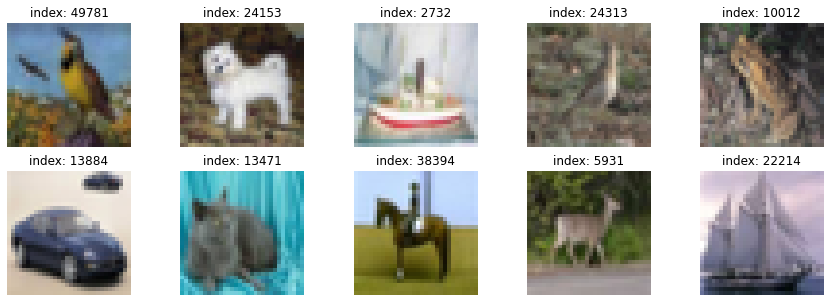

In [ ]:
plt.figure(figsize=(15, 5))

for i in range(10):
    plt.subplot(2, 5, i+1)
    random_index = np.random.randint(1, 50000)
    plt.imshow((train_x[random_index] + 1)/2)
    plt.title(f'index: {random_index}')
    plt.axis('off')
plt.show()

⏳ for 문을 통해 CIFAR-10 dataset 을 잘 들고 온 것을 확인 할 수 있다.

### STEP 3. 생성자 모델 구현하기

- (32, 32, 3)의 shape를 가진 이미지를 생성하는 생성자 모델 구현

- `noise = tf.random.normal([1, 100])` 로 생성된 랜덤 노이즈를 입력하여 구현한 생성자로 랜덤 이미지를 생성

- 생성된 랜덤 이미지가 생성자 출력 규격에 잘 맞는지 확인

⏳ 구현해 볼 모델은 DCGAN(Deep ConvolutionalGAN) 이다.
DCGAN 은 GAN 의 개념이 처음 소개된 1년 반 이후 발표된 논문으로 이전의 GAN을 발전시켜
고화질의 이미지 생성을 이루어낸 첫 번째 논문으로 평가받고 있다.

이후 발표된 수 많은 GAN 기반 이미 생성 모델들은 대부분 DCGAN 모델을 발전시킨 형태이다.

모델의 구현은 Keras Sequential API 를 활용할 것이다.

- [Tensorflow 2.0 Tutorial](https://www.tensorflow.org/tutorials/generative/dcgan?hl=ko) 의 DCGAN 구현을 기반으로 상세한 설명을 추가하였다.

**▶ Generator Model One** 

In [ ]:
def make_generator_model_one():
    
    # Start
    model = tf.keras.Sequential()
    
    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))
    
    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    
    return model

In [ ]:
generator_one = make_generator_model_one()

generator_one.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 16384)             1638400   
                                                                 
 batch_normalization_3 (Batc  (None, 16384)            65536     
 hNormalization)                                                 
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 16384)             0         
                                                                 
 reshape_1 (Reshape)         (None, 8, 8, 256)         0         
                                                                 
 conv2d_transpose_3 (Conv2DT  (None, 8, 8, 128)        819200    
 ranspose)                                                       
                                                                 
 batch_normalization_4 (Batc  (None, 8, 8, 128)       

In [ ]:
# 노이즈를 생성합니다.
noise = tf.random.normal([1, 100])
generated_image = generator_one(noise, training=False)
generated_image.shape

TensorShape([1, 32, 32, 3])

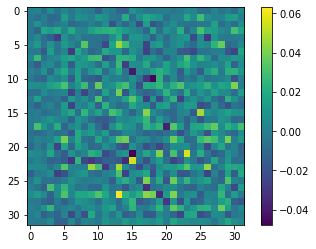

In [ ]:
plt.imshow(generated_image[0, :, :, 0])
plt.colorbar()
plt.show()

### STEP 4. 판별자 모델 구현하기

- (32, 32, 3)의 이미지를 입력으로 받아 1dim을 판별결과를 출력하는 판별자 모델 구현

- STEP 2에서 생성한 랜덤 이미지를 판별자 모델이 판별한 결과값을 확인

⏳ 판별자는 가짜 이미지와 진짜 이미지를 입력받으면 각 이미지 별로 '진짜라고 판단되는 정도' 값을 출력한다.   
입력은 (32, 32, 3) 크기의 이미지가, 출력은 단 하나의 실수값(진짜라고 판단하는 정도) 이다.

**▶ Discriminator Model One** 

In [ ]:
def make_discriminator_model_one():
    
    # Start
    model = tf.keras.Sequential()
    
    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    # Third: Flatten Layer
    model.add(layers.Flatten())
    
    # Fourth: Dense Layer
    model.add(layers.Dense(1))
    
    return model

In [ ]:
discriminator_one = make_discriminator_model_one()

discriminator_one.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 16, 16, 64)        4864      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 16, 16, 64)        0         
                                                                 
 dropout (Dropout)           (None, 16, 16, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 8, 8, 128)         204928    
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 dropout_1 (Dropout)         (None, 8, 8, 128)         0         
                                                                 
 flatten (Flatten)           (None, 8192)             

In [ ]:
decision = discriminator_one(generated_image, training=False)

### STEP 5. 손실함수와 최적화 함수 구현하기

- 생성자와 판별자의 손실함수(loss)를 구현

- 판별자의 출력값을 가지고 실제/생성(real/fake) 이미지 판별 정확도(accuracy)를 계산하는 함수를 구현

- 생성자와 판별자를 최적화하는 optimizer를 정의


#### ▶ 손실함수(loss function)
___
GAN 은 손실함수로 교차 엔트로피(Cross Entropy)를 사용한다.
교차 엔트로피는 두 값이 가까워지기 원하는 것으로 얼마나 큰 차이가 나는지를 정량적으로 계산할 때 많이 쓰인다.
판별자는 한 개의 이미지가 가까인지 진짜인지 나타내는 2개 클래스 간 분류 문제를 풀어야 하므로,
**이진 교차 엔트로피(binary corss entropy)** 를 사용할 것이다.

- Real Image 에 대한 label 을 `1`

- Fake Image 에 대한 label 을 `0`

각각의 손실함수를 이용해 정량적으로 달성해야하는 결과는 아래와 같을 것이다.

- 생성자: 판별자가 Fake Image 에 대해 판별한 값, 즉 D(fake_image) 값이 1 에 가까워지는 것

- 판별자:

  - Real Image 판별값, 즉 `D(real_image)` 는 `1` 에,
  - Fake Image 판별값, 즉 `D(fake_image)` 는 `0` 에 가까워지는 것   
생성자는 판별자든, 결국 손실함수에 들어가는 값은 모두 선별자의 판별값이 될 것이다.

손실함수에 사용할 교차 엔트로피 함수는 `tf.keras.losses` 라이브러리 안에 있다.

교차 엔트로피를 계산하기 위해 입력할 값은 판별자가 판별한 값인데,
판별자 모델의 마지막 Layer 에는 값을 정규화시키는 **sigmoid** 나 **tanh** 함수와 같은 활성화 함수가 없다.
판별자가 출력하는 값은 범위가 정해지지 않아 모든 실수값을 가질 수 있다.

그런데 `tf.keras.losses` 의 `BinaryCrossEntropy` 클래스는 기본적으로 본인에게 들어오는 인풋값이
0 - 1 사이에 분포하는 확률값이라 가정한다(참고). 따라서 `from_logits` 를 `True` 로 설정해 줘야 `BinaryCrossEntropy` 에 입력된 값을
함수 내부에서 sigmoid 함수를 사용해 0 ~ 1 사이의 값으로 정규화 한 후 계산할 수 있다.

⏳ `cross_entropy` 를 활용해 계산할 loss 들은 `fake_output` 과 `real_output`, 두 가지를 활용한다.

- `fake_output`: 생성자가 생성한 Fake Image 를 구분자에 입력시켜 판별된 값, 즉 `D(fake_image)`

- `real_output`: 기존에 있던 Real Image 를 구분자에 입력시켜 판별된 값, 즉 `D(real_image)`

⏳ `fake_output` 과 `real_output` 을 `tf.ones_like()` 와 `tf.zeros_like()` 함수를 이용해서 각각 1 또는 0 을 비교해보자.


⏳ 이 함수들은 특정 벡터와 동일한 크기이면서 값은 1 또는 0 으로 가득 채워진 벡터를 만들고 싶을 때 사용한다.

⤵⤵⤵⤵⤵⤵

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

**▶ generator_loss**
___

⏳  `generator_loss` 는 `fake_output` 이 1에 가까워지기를 바라므로, `tf.ones_like()` 와의
교차 엔트로피 값을 계산하면 된다.

⏳  즉, `cross_entropy(tf.ones_like(fake_output), fake_output)` 값은   
`fake_output` 이 (Real Image 를 의미하는) 1에 가까울수록 작은 값을 가진다.

⤵⤵⤵⤵⤵⤵

In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

**▶ discriminator_loss**
___

⏳ `discriminator_loss` 는 `real_output` 값은 1에 가까워지기를,   
`fake_output` 값은 0에 가까워지기를 바라므로, 두 가지 loss값을 모두 계산한다.   
`real_output` 은 1로 채워진 벡터와, `fake_output` 은 0으로 채워진 벡터와 비교하면 된다.

⏳ 최종 `discriminator_loss` 값은 이 둘을 더한 값이다.

⤵⤵⤵⤵⤵⤵

In [ ]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

**▶ discriminator accuracy**
___

⏳ 판별자가 real output, fake output 을 얼마나 정확히 판별하는지의 accuracy 를 계산하는 것도 GAN의 학습에서 중요하다.   
특히 두 accuracy 를 따로 계산해서 비교하는 것이 매우 유용할 것이다.

⏳ 만약 판별자가 real output 과 fake output 을 accuracy 가 1.0 에 가까울 정도로 정확하게 판별하는 것이 좋은걸까❓❓❓


⏳ 그렇지 않다. 이 경우 생성자가 만들어내는 fake output 이 real output 과 차이가 많이 나기 때문에
판별자가 매우 쉽게 판별해 내고 있다는 뜻이다.


⏳ 그래서, real accuracy 와 fake accuracy 는 초반에는 1.0 에 가깝게 나오다가, 서서히 낮아져 둘 다 0.5에 가까워지는 것이 이상적이다.


🔥 **fake accuracy 가 1.0 에 더 가깝다면 아직은 생성자가 판별자를 잘 속이지 못하고 있다는 뜻이다.** 🔥

⤵⤵⤵⤵⤵⤵

In [ ]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

#### ▶ 최적화 함수(optimizer)
___

Adam 최적화 기법 을 활용해서 만들어보자.

- [신경망 학습 최적화](https://sacko.tistory.com/42)


⏳ Adam 함수 또한 `tf.keras.optimizers` 안에 있다. 중요한 하이퍼 파라미터인 "learning rate"는 0.0001로 설정 하고,   
학습 품질을 올려보고 싶다면 여러 가지로 값을 바꾸어 가며 학습을 진행해 보자.

⏳ 중요한 점 한 가지는 생성자와 구분자는 따로따로 학습을 진행하는 개별 네트워크이기 때문에   
optimizer를 따로 만들어주어야 한다는 점이다.

⤵⤵⤵⤵⤵⤵

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

⏳ 샘플은 한번에 16장 생성

⏳ 생성할 샘플은 같은 노이즈로 생성해야 그에 대한 진전 과정을 확인할 수 있어서, 고정된 seed 노이즈를 만들어야 한다.

100차원의 노이즈를 총 16개, `(16, 100)` 형상의 벡터를 만들어보자.

⤵⤵⤵⤵⤵⤵

In [ ]:
noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

### STEP 6. 훈련과정 상세 기능 구현하기

- 1개 미니배치의 훈련 과정을 처리하는 `train_step()` 함수를 구현

- 16개의 고정된 seed를 입력으로 하여 훈련 과정 동안 생성한 이미지를 시각화하는 `generate_and_save_images()` 함수를 구현

- 훈련 epoch마다 생성자/판별자의 loss 및 판별자의 실제/생성(real/fake) 이미지 판별 accuracy 히스토리(history)를  
그래프로 시각화하는 `draw_train_history()` 함수를 구현

- training_checkpoints 디렉토리에 몇 epoch마다 모델을 저장하는 checkpoint 모듈을 설정

In [ ]:
BUFFER_SIZE = 50000
BATCH_SIZE = 256

In [ ]:
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [ ]:
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator_one(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator_one(images, training=True)
        fake_output = discriminator_one(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator_one.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator_one.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator_one.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator_one.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

⏳ train_step 함수를 하나하나 뜯어보자.

1. **입력 데이터**: Real Image 역할을 할 images 한 세트를 입력으로 받음

2. **생성자 입력 노이즈**: generator가 FAKE IMAGE를 생성하기 위한 noise를 images 한 세트와 같은 크기인 BATCH_SIZE 만큼 생성함

3. `tf.GradientTape()` 는 가중치 갱신을 위한 Gradient를 자동 미분으로 계산하기 위해 with 구문 열기

4. **generated_images 생성**: generator가 noise를 입력받은 후 generated_images 생성

5. **discriminator 판별**: discriminator가 Real Image인 images와 Fake Image인.  
generated_images를 각각 입력받은 후 real_output, fake_output 출력

6. **loss 계산**: fake_output, real_output으로 generator와 discriminator 각각의 loss 계산

7. **accuracy 계산**: fake_output, real_output으로 discriminator의 정확도 계산

8. **gradient 계산**: gen_tape와 disc_tape를 활용해 gradient를 자동으로 계산

9. **모델 학습**: 계산된 gradient를 optimizer에 입력해 가중치 갱신

10. **리턴값**: 이번 스텝에 계산된 loss와 accuracy를 리턴

⏳ 한 단계식 학습할 train_step 과 함께 일정 간격으로 학습 현황을 볼 수 있는 함수 설계

⏳ 만들어 놓은 고정된 seed 를 이용해서 결과물을 만들어내므로, 고정된 seed 에 대한 결과물이 개선되는 모습이 확인 가능하다.

In [ ]:
def generate_and_save_images(model, epoch, it, sample_seeds):
    
    predictions = model(sample_seeds, training=False)
    
    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        plt.imshow(np.array(predictions[i] * 127.5 + 127.5).astype('uint8'))
        plt.axis('off')
        
    plt.savefig('/content/drive/MyDrive/AIFFEL/data/fashion/generated_samples/EX01_epoch_{:04d}_iter_{:03d}.png'.format(epoch, it))
    
    plt.show()

In [ ]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6 # matlab 차트의 기본 크기를 15, 6 으로 지정

def draw_train_history(history, epoch):
    # summarize history for loss
    plt.subplot(211)
    plt.plot(history['gen_loss'])
    plt.plot(history['disc_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('batch iters')
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')
    
    # summarize history for accuracy
    plt.subplot(212)
    plt.plot(history['fake_accuracy'])
    plt.plot(history['real_accuracy'])
    plt.title('discriminator accuracy')
    plt.xlabel('batch iters')
    plt.ylabel('accuracy')
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')
    
    # training_history 디렉토리에 epoch 별로 그래프를 이미지 파일로 저장
    plt.savefig('/content/drive/MyDrive/AIFFEL/data/fashion/training_history/EX01_train_history_{:04d}.png'.format(epoch))
    
    plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/AIFFEL/data/fashion/EX01_training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator_one,
                                 discriminator=discriminator_one)

### STEP 7. 학습 과정 진행하기

- 위 STEP 5에서 구현한 기능들을 활용하여 최소 50 epoch만큼의 모델 학습을 진행

- 학습 과정에서 생성된 샘플 이미지로 만든 gif 파일을 통해 학습 진행 과정을 시각적으로 표현

- 학습 과정을 담은 샘플 이미지, gif 파일, 학습 진행 그래프 이미지를 생성

지금까지 위에서 한 단계를 학습하는 `train_step`,

샘플 이미지를 생성하고 저장하기 위한 `generate_and_save_images()`,

학습과정을 시각화하는 `draw_train_history()`,

모델까지 저장하기 위한 `checkpoint` 를 준비하였다.

🔥 이 모든 것을 한곳에 합쳐주자. 🔥

⤵⤵⤵⤵⤵⤵

In [ ]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator_one, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator_one, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

⏳ 모델을 저장하는 간격은 `save_every` 와 전체 학습 에폭을 결정하는 `EPOCHS` 파라미터 설정 후 훈련을 해보자.

⏳ 다음과 같이 `train()` 함수를 실행시켜 모델이 학습하는 결과물을 실시간으로 확인이 가능하다.

In [ ]:
save_every = 5
EPOCHS = 300

In [ ]:
%%time
with tf.device('/GPU:0'):
    train(train_dataset, EPOCHS, save_every)

In [ ]:
anim_file = '/content/drive/MyDrive/AIFFEL/data/fashion/EX01_fashion_mnist_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('/content/drive/MyDrive/AIFFEL/data/fashion/generated_samples/EX01_epoch*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l /content/drive/MyDrive/AIFFEL/data/fashion/EX01_fashion_mnist_dcgan.gif

-rw------- 1 root root 5841900 Feb 15 00:25 /content/drive/MyDrive/AIFFEL/data/fashion/EX01_fashion_mnist_dcgan.gif


❎ Model one (generator, discriminator) 에 대한 결과를 시각화하였다.

이쁘다.

어쨌든 이미지 생성에 있어서는 실패하였으니 수정이 필요할 것 같다.

In [ ]:
anim_file = '/content/drive/MyDrive/AIFFEL/data/fashion/EX01_fashion_loss_accuracy.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('/content/drive/MyDrive/AIFFEL/data/fashion/training_history/EX01_train_history*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l /content/drive/MyDrive/AIFFEL/data/fashion/EX01_fashion_loss_accuracy.gif

-rw------- 1 root root 1440772 Feb 15 00:25 /content/drive/MyDrive/AIFFEL/data/fashion/EX01_fashion_loss_accuracy.gif


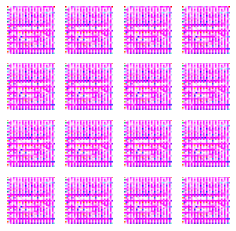

Time for training : 2705 sec

❎ fake accuracy 가 1.0 에 더 가깝다 못해 그냥 1이다.

이 또한 성능 개선을 위해 뭔가를 해야 할 것 같다.

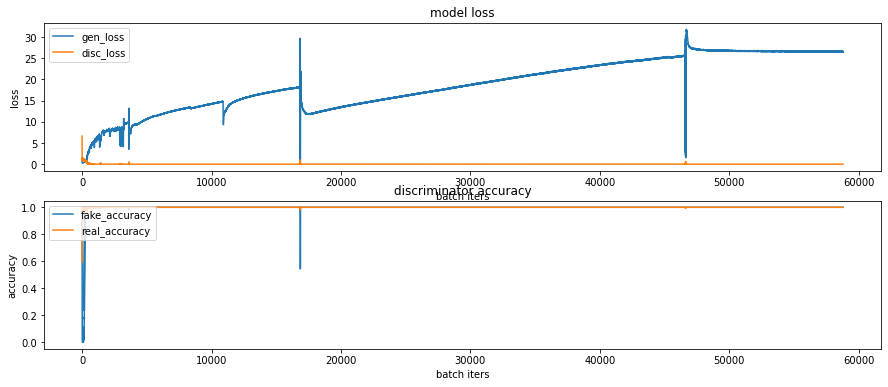

CPU times: user 27min 1s, sys: 51.2 s, total: 27min 53s
Wall time: 45min 7s

### STEP 8. (optional) GAN 훈련 과정 개선하기

#### ❗ 개선 모델 Model Two ❗

**▶ generator_model_two**

In [ ]:
def make_generator_model_two():

  model = tf.keras.Sequential()
  
  model.add(layers.Dense(8 * 8 * 128, activation='relu', input_shape=(100,)))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  model.add(layers.Reshape((8, 8, 128)))

  model.add(layers.Conv2D(128, kernel_size=4, strides=1, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  model.add(layers.Conv2DTranspose(128, 4, strides=2, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  model.add(layers.Conv2D(128, kernel_size=5, strides=1,padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  model.add(layers.Conv2DTranspose(128, 4, strides=2, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  model.add(layers.Conv2D(128, kernel_size=5, strides=1, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))
                      
  model.add(layers.Conv2D(3, kernel_size=5, strides=1, padding="same", activation='tanh'))
  
  return model

In [ ]:
generator_two = make_generator_model_two()

generator_two.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 8192)              827392    
                                                                 
 batch_normalization_6 (Batc  (None, 8192)             32768     
 hNormalization)                                                 
                                                                 
 leaky_re_lu_8 (LeakyReLU)   (None, 8192)              0         
                                                                 
 reshape_2 (Reshape)         (None, 8, 8, 128)         0         
                                                                 
 conv2d_2 (Conv2D)           (None, 8, 8, 128)         262272    
                                                                 
 batch_normalization_7 (Batc  (None, 8, 8, 128)        512       
 hNormalization)                                      

In [ ]:
# 노이즈를 생성합니다.
noise = tf.random.normal([1, 100])
generated_image = generator_two(noise, training=False)
generated_image.shape

TensorShape([1, 32, 32, 3])

**▶ Discriminator Model Two** 

In [ ]:
def make_discriminator_model_two():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(32, kernel_size=3, strides=2, input_shape=(32, 32, 3), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(64, kernel_size=3, strides=2, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.8))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(128, kernel_size=3, strides=2, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.8))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(256, kernel_size=3, strides=1, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.8))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Flatten())
    model.add(layers.Dense(1, activation='sigmoid'))

    return model

In [ ]:
discriminator_two = make_discriminator_model_two()

discriminator_two.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 16, 16, 32)        896       
                                                                 
 leaky_re_lu_14 (LeakyReLU)  (None, 16, 16, 32)        0         
                                                                 
 dropout_2 (Dropout)         (None, 16, 16, 32)        0         
                                                                 
 conv2d_7 (Conv2D)           (None, 8, 8, 64)          18496     
                                                                 
 batch_normalization_12 (Bat  (None, 8, 8, 64)         256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_15 (LeakyReLU)  (None, 8, 8, 64)          0         
                                                      

In [ ]:
save_every = 5
EPOCHS = 300

**▶ Model Two** 

In [ ]:
%%time
with tf.device('/GPU:0'):
    train(train_dataset, EPOCHS, save_every)

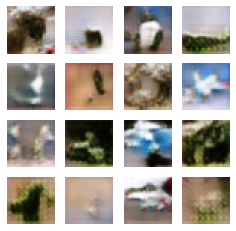

Time for training : 2425 sec

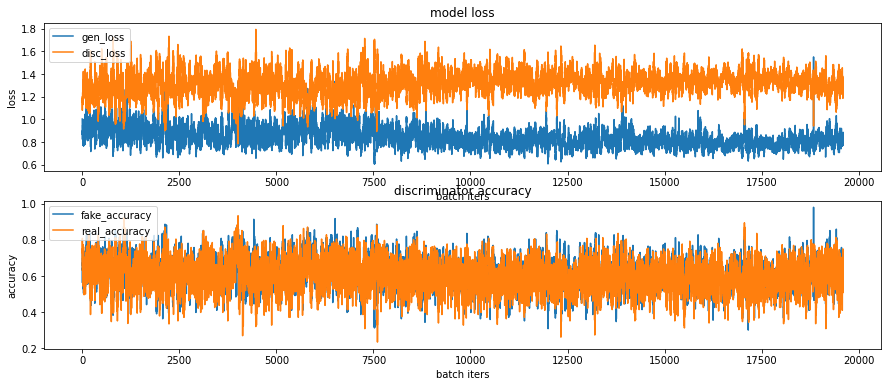

CPU times: user 40min 45s, sys: 23.8 s, total: 41min 9s
Wall time: 40min 26s

#### ❗ 개선 모델 Model Three ❗

**▶ Generator Model Three** 

In [ ]:
def make_generator_model_three(in_shape=(32, 32, 3)):

    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,), activation='relu'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))

    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))

    return model

In [ ]:
generator_three = make_generator_model_three()

generator_three.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_5 (Dense)             (None, 16384)             1638400   
                                                                 
 batch_normalization_15 (Bat  (None, 16384)            65536     
 chNormalization)                                                
                                                                 
 leaky_re_lu_18 (LeakyReLU)  (None, 16384)             0         
                                                                 
 reshape_3 (Reshape)         (None, 8, 8, 256)         0         
                                                                 
 conv2d_transpose_8 (Conv2DT  (None, 8, 8, 128)        819200    
 ranspose)                                                       
                                                                 
 batch_normalization_16 (Bat  (None, 8, 8, 128)       

In [ ]:
# 노이즈를 생성합니다.
noise = tf.random.normal([1, 100])
generated_image = generator_three(noise, training=False)
generated_image.shape

TensorShape([1, 32, 32, 3])

**▶ Discriminator Model Three** 

In [ ]:
def make_discriminator_model_three():
    
    model = tf.keras.Sequential()
    
    model.add(layers.Conv2D(64, (3, 3), activation='relu', padding='same', input_shape=[32, 32, 3]))
    model.add(layers.Conv2D(64, (3, 3), activation='relu', padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    model.add(layers.Dropout(0.25))
    
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    model.add(layers.Dropout(0.25))
    
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    model.add(layers.Dropout(0.25))
    
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    model.add(layers.Dropout(0.25))
    model.add(layers.Flatten())
    
    model.add(layers.Dense(512, activation='relu'))
    
    model.add(layers.Dense(1, activation='sigmoid'))
    
    return model    

In [ ]:
discriminator_three = make_discriminator_model_three()

discriminator_three.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_10 (Conv2D)          (None, 32, 32, 64)        1792      
                                                                 
 conv2d_11 (Conv2D)          (None, 32, 32, 64)        36928     
                                                                 
 batch_normalization_18 (Bat  (None, 32, 32, 64)       256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_21 (LeakyReLU)  (None, 32, 32, 64)        0         
                                                                 
 dropout_6 (Dropout)         (None, 32, 32, 64)        0         
                                                                 
 conv2d_12 (Conv2D)          (None, 32, 32, 128)       73856     
                                                      

In [ ]:
save_every = 5
EPOCHS = 25

In [ ]:
%%time
with tf.device('/GPU:0'):
    train(train_dataset, EPOCHS, save_every)

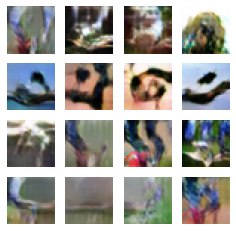

Time for training : 167016 sec

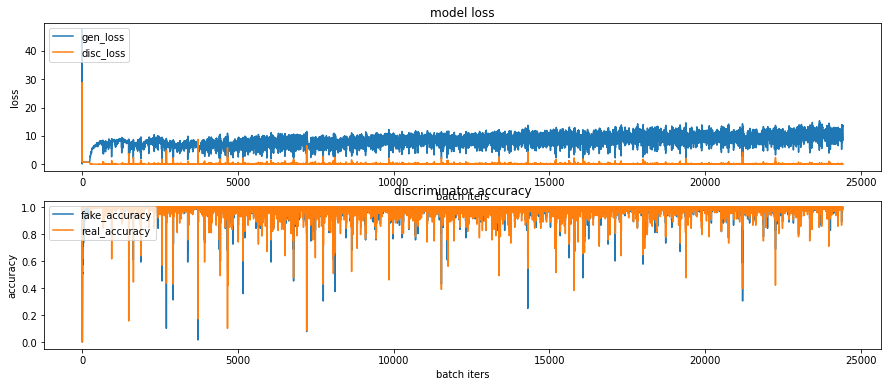

CPU times: user 13d 13h 42min 19s, sys: 1d 2h 16min 46s, total: 14d 15h 59min 5s
Wall time: 1d 22h 23min 37s

#### ❗ 개선 모델 Model Four ❗

**▶ Generator Model Four** 

In [ ]:
def make_generator_model_four():

  model = tf.keras.Sequential()
  
  # first: Dense layer
  model.add(layers.Dense(8 * 8 * 128, activation='relu', input_shape=(100,)))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))
  
  # second: Reshape layer
  model.add(layers.Reshape((8, 8, 128)))

  # third: Conv2D layer
  model.add(layers.Conv2D(128, kernel_size=4, strides=1, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  # fourth: Conv2DTranspose layer
  model.add(layers.Conv2DTranspose(128, 4, strides=2, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  # fifth: Conv2D layer
  model.add(layers.Conv2D(128, kernel_size=5, strides=1,padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  # sixth: Conv2DTranspose layer
  model.add(layers.Conv2DTranspose(128, 4, strides=2, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  # seventh: Conv2D layer
  model.add(layers.Conv2D(128, kernel_size=5, strides=1, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  # eigth: Conv2D layer                   
  model.add(layers.Conv2D(3, kernel_size=5, strides=1, padding="same", activation='tanh'))
  
  return model

In [ ]:
generator_four = make_generator_model_four()

generator_four.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 8192)              827392    
                                                                 
 batch_normalization_22 (Bat  (None, 8192)             32768     
 chNormalization)                                                
                                                                 
 leaky_re_lu_25 (LeakyReLU)  (None, 8192)              0         
                                                                 
 reshape_4 (Reshape)         (None, 8, 8, 128)         0         
                                                                 
 conv2d_18 (Conv2D)          (None, 8, 8, 128)         262272    
                                                                 
 batch_normalization_23 (Bat  (None, 8, 8, 128)        512       
 chNormalization)                                     

In [ ]:
# 노이즈를 생성합니다.
noise = tf.random.normal([1, 100])
generated_image = generator_four(noise, training=False)
generated_image.shape

TensorShape([1, 32, 32, 3])

**▶ Discriminator Model Four** 

In [ ]:
def make_discriminator_model_four():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(128, kernel_size=3, strides=1, input_shape=(32, 32, 3), padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Flatten())

    model.add(layers.Dense(512, activation='relu'))


    model.add(layers.Dense(1, activation='sigmoid'))

    return model

In [ ]:
discriminator_four = make_discriminator_model_four()

discriminator_four.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_22 (Conv2D)          (None, 32, 32, 128)       3584      
                                                                 
 batch_normalization_28 (Bat  (None, 32, 32, 128)      512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_31 (LeakyReLU)  (None, 32, 32, 128)       0         
                                                                 
 dropout_10 (Dropout)        (None, 32, 32, 128)       0         
                                                                 
 conv2d_23 (Conv2D)          (None, 16, 16, 128)       262272    
                                                                 
 batch_normalization_29 (Bat  (None, 16, 16, 128)      512       
 chNormalization)                                     

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1=0.5)

In [ ]:
BUFFER_SIZE = 50000
BATCH_SIZE = 16

In [ ]:
save_every = 5
EPOCHS = 100

In [ ]:
%%time
with tf.device('/GPU:0'):
    train(train_dataset, EPOCHS, save_every)

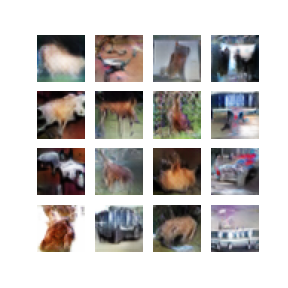

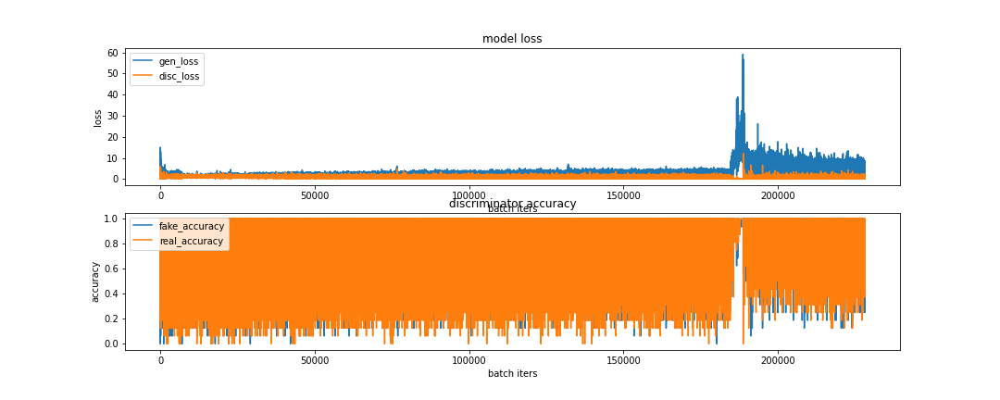

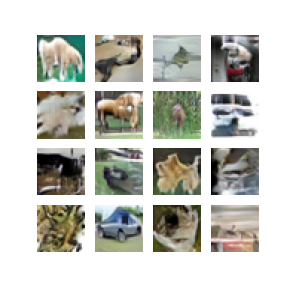

In [ ]:
from IPython.display import Image
Image('/content/drive/MyDrive/AIFFEL/data/fashion/generated_samples/EX01_epoch_0046_iter_3051.png')


**❗ 마지막 수정 코드가 잘나온 것 같다**

- Model Four

## 루브릭
___


|제목|내용|
|:---|:---|
|1. GAN의 두 모델 구조를 통해 이미지를 성공적으로 생성하였다.|오브젝트 종류를 육안으로 구별할 수 있을 만한 이미지를 생성하였다.|
|2. 생성 이미지 시각화 및 학습 그래프를 통해 GAN 학습이 바르게 진행되었음을 입증하였다.|gif를 통해 생성이미지 품질이 서서히 향상되는 것과, fake accuracy가 추세적으로 0.5를 향해 하향하고 있음을 확인하였다.|
|3. 추가적인 GAN 모델구조 혹은 학습과정 개선 아이디어를 제안하고 이를 적용하였다.|제출 아이디어를 제출 프로젝트에 반영하고, 그 결과가 아이디어 적용 이전보다 향상되었음을 시각적으로 입증하였다.|

## 결과 정리

**▶ Model One**

- generator

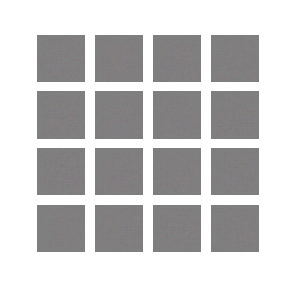

- training history

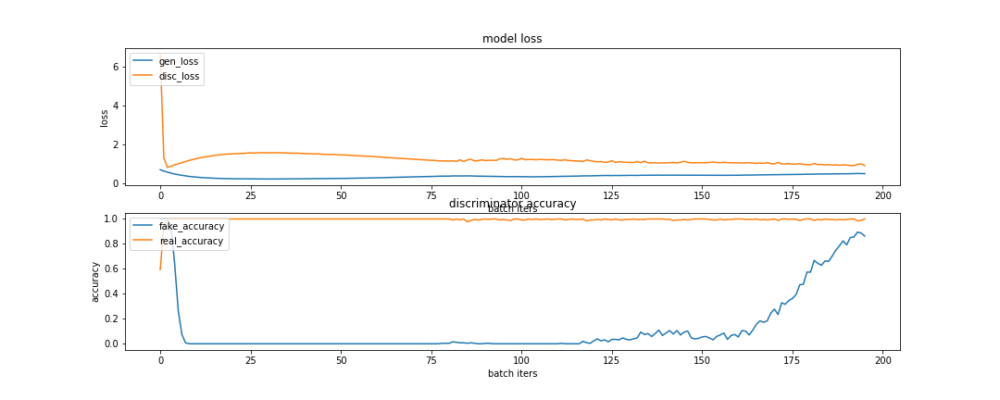

**▶ Model Two**

- generator

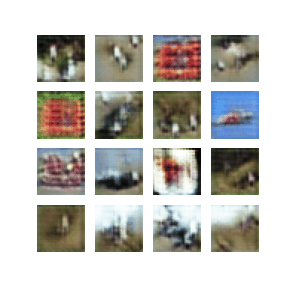

- training history

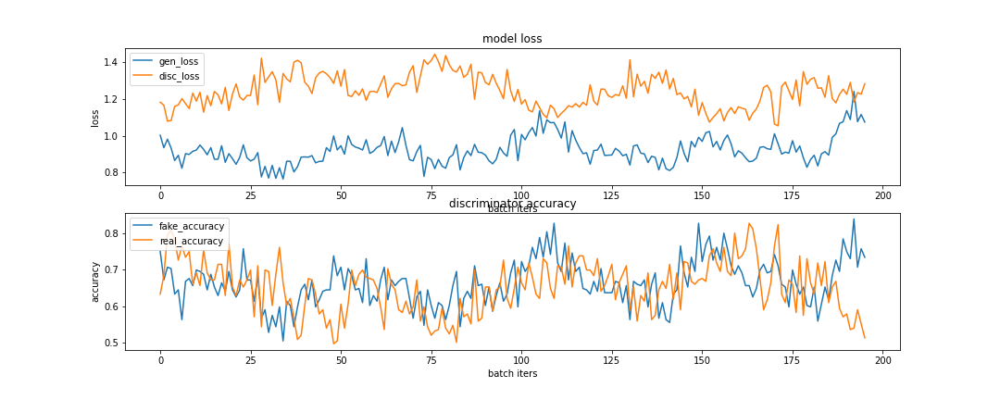

**▶ Model Three**

- generator

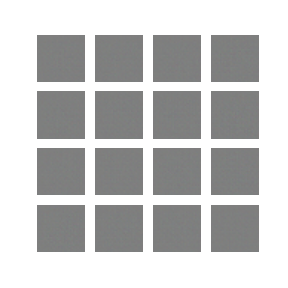

- training history

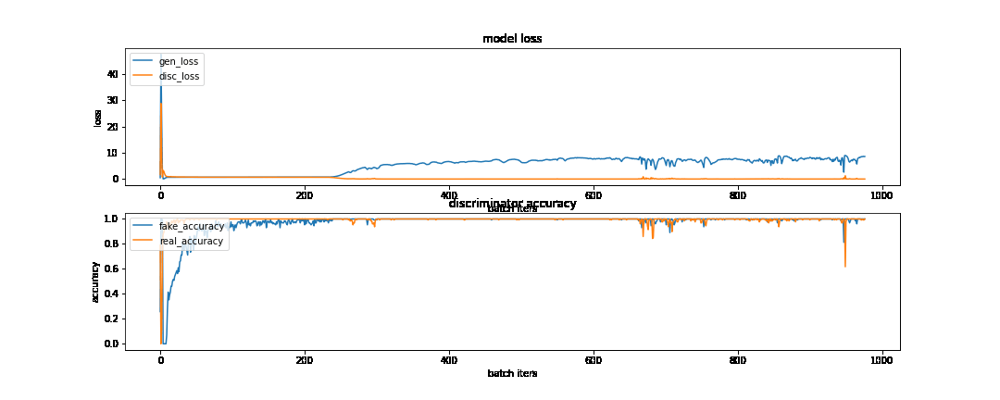

**▶ Model Four**

- generator

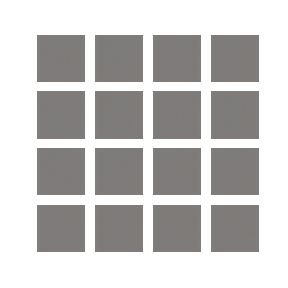

- training history

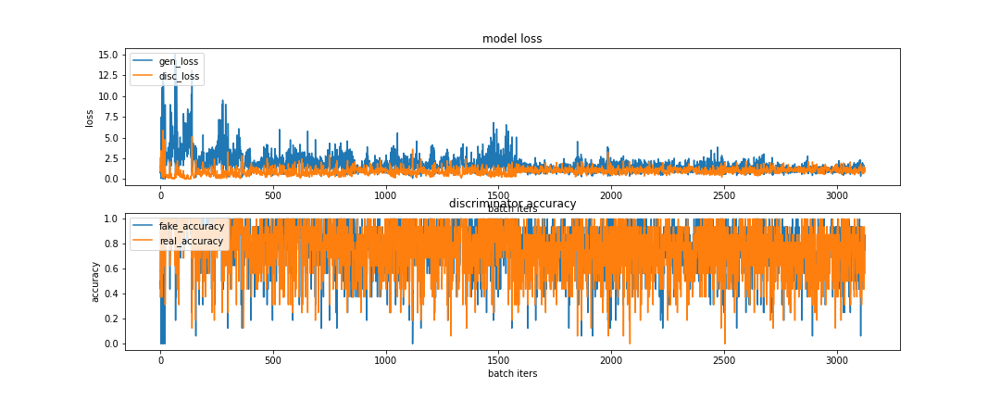

**▶ Model One**


In [ ]:
generator_one.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 16384)             1638400   
                                                                 
 batch_normalization_3 (Batc  (None, 16384)            65536     
 hNormalization)                                                 
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 16384)             0         
                                                                 
 reshape_1 (Reshape)         (None, 8, 8, 256)         0         
                                                                 
 conv2d_transpose_3 (Conv2DT  (None, 8, 8, 128)        819200    
 ranspose)                                                       
                                                                 
 batch_normalization_4 (Batc  (None, 8, 8, 128)       

⏳ make_generator_model 함수를 만들어 언제든 생성자를 생성가능하게 만들었다.

⏳ 함수 내부에서는 먼저 `tf.keras.Sequential()` 로 모델을 시작한 후 레이어를 쌓아준다.

⏳ 중요한 레이어는 `Conv2DTranspose` 레이어다.   
`Con2DTranspose` 층은 일반적인 Conv2D와 반대로 이미지 사이즈를 넓혀주는 층이다.
이 모델에서는 세 번의 Conv2DTranspose 층을 이용해 (8, 8, 128) → (16, 16, 64) → (32, 32, 3)
순으로 이미지를 키워나간다.

⏳ 최종 사이즈는 (32, 32, 3)로 준비했던 데이터셋과 형상이 동일하다.

**What is Transposed Convolutional Layer❓❓❓**

⏳ 레이어의 사이사이에 특정 층들이 반복되는 것을 볼 수 있다.
`BatchNormalization` 레이어는 신경망의 가중치가 폭발하지 않도록 가중치 값을 정규화 시켜준다.

⏳ 중간층들의 활성화 함수는 모두 LeakyReLU 를 사용하였으며,   
마지막 층에는 tanh(하이퍼볼릭탄젠트 함수로 시그모이드 함수를 transformation해서 얻을 수 있다.)를 사용하는데,
이유는 (-1 ~ 1) 이내의 값으로 픽셀 값을 정규화시켰던 데이터셋과 동일하게 하기 위함이다.


**🔥 Model One 에 대한 결론은 좋지 못하다**

▶ Model Four

In [ ]:
generator_four.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 8192)              827392    
                                                                 
 batch_normalization_22 (Bat  (None, 8192)             32768     
 chNormalization)                                                
                                                                 
 leaky_re_lu_25 (LeakyReLU)  (None, 8192)              0         
                                                                 
 reshape_4 (Reshape)         (None, 8, 8, 128)         0         
                                                                 
 conv2d_18 (Conv2D)          (None, 8, 8, 128)         262272    
                                                                 
 batch_normalization_23 (Bat  (None, 8, 8, 128)        512       
 chNormalization)                                     

✅ Model Four 차이점

⏳ 전체적인 `generator model`, `discriminator model` 의 설계

```
model.add(layers.BatchNormalization(momentum=0.9))
model.add(layers.LeakyReLU(alpha=0.1))

# momentum=0.9 와 alpha=0.1 추가
```
[BatchNormalization 의 momentum](https://medium.com/@ilango100/batchnorm-fine-tune-your-booster-bef9f9493e22)

⏳ optimizer
```
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1=0.5)
```

⏳ BATCH_SIZE
```
BATCH_SIZE = 16
```

⏳ EPOCH
```
EPOCH = 100
```

### ⛳ 회고 ⛳

- 학습 시간은 오래걸리고 많지 않은 시간으로 여러방면으로 시도를 못해본 것이 아쉽다.

- 그래도 짧은 시간 안에 만족할만한 결과가 나왔다.

- Model One 에서 아름다운 결과물 도출로 개선이 시급하여 다양한 시도를 해보았다.

- Model 의 층이 깊어지고 BatchNormalization 및 LeakyReLu 설정 값을 통해 이미지 생성 성능 향상이 가능하다.

- optimizer 의 Adam 설정 값의 변화를 주었는데 효과 성능 검증은 한번 더 진행 해봐야 정확할 것 같다.

- [GAN-DCGAN(Deep convolutional generative adversarial networks)](https://jonathan-hui.medium.com/gan-dcgan-deep-convolutional-generative-adversarial-networks-df855c438f)

